In [1]:
import numpy as np
import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.path import Path
from scipy.spatial import Delaunay
from scipy.spatial.transform import Rotation as R

%matplotlib inline
%config InlineBackend.figure_format='retina'
plt.rcParams['text.usetex'] = True

## Processing GeoTIFF Data

The following GEOTIFF file was obtained from USGS 3D Elevation Program (3DEP). It contains elevation data measured at roughly 10 meter (1/3 arc-second) increments. USGS elevation data files are typically provided spanning a single degree of longitude and latitude.

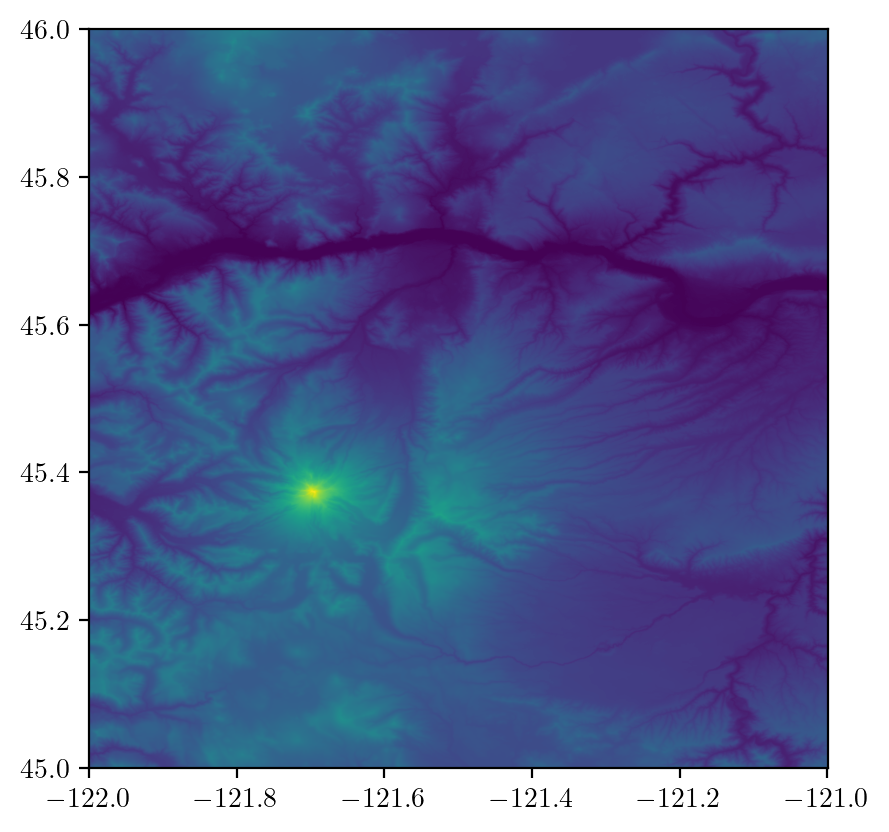

In [3]:
fp = r'USGS_13_n46w122_20211129.tif'
hood = rasterio.open(fp)
show(hood)
plt.show()

### Resampling

If we compare the image above to a standard map of the area, some distortion immediately becomes evident. This is due to the fact that the distance spanned by 1 degree of longitude does not equal the distance spanned by 1 degree of latitude. A single degree of latitude spans roughly 69.06 miles, while at 45.4° N a degree of longitude spans approximately 48.65 miles. There are also nonlinear distortions, but these are small enough to be relatively inconsequential at the scale we're interested in. For our purposes, we can simply resample each row using linear interpolation at a ratio of 4865/6906.

(1700, 1761)
11241


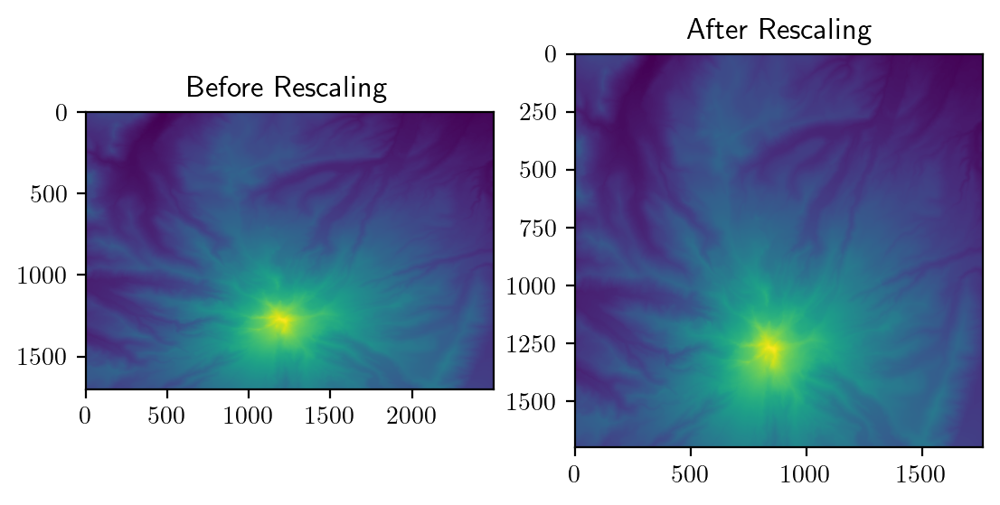

In [4]:
# Read data only in neighborhood of Mount Hood
x_west, x_east = 8205, 9370
y_south, y_north = 8000, 9300
x_range = x_east - x_west
y_range = y_north - y_south

hood_data = hood.read(1)[5500:7200,2075:4575]
width = hood_data.shape[1]

lat_long_ratio = 4865/6906
ls = np.linspace(0, width, int(lat_long_ratio * width))

# Would be faster as vectorized operation but fast enough as is
resampled = np.array([np.interp(ls, np.arange(width), ys) for ys in hood_data])
print(resampled.shape)

fix, ax = plt.subplots(1,2)
ax[0].imshow(hood_data)
ax[0].title.set_text("Before Rescaling")
ax[1].imshow(resampled)
ax[1].title.set_text("After Rescaling")

# Display high point after converting meters to feet
high_point = int(np.max(hood_data) / 0.3048)
print(high_point)

The highest sampled elevation is 8,317', which is roughly 45' short of the true high point. This can be explained by the limited sampling resolution as well as error in sample data.

## Generating contours and rescaling

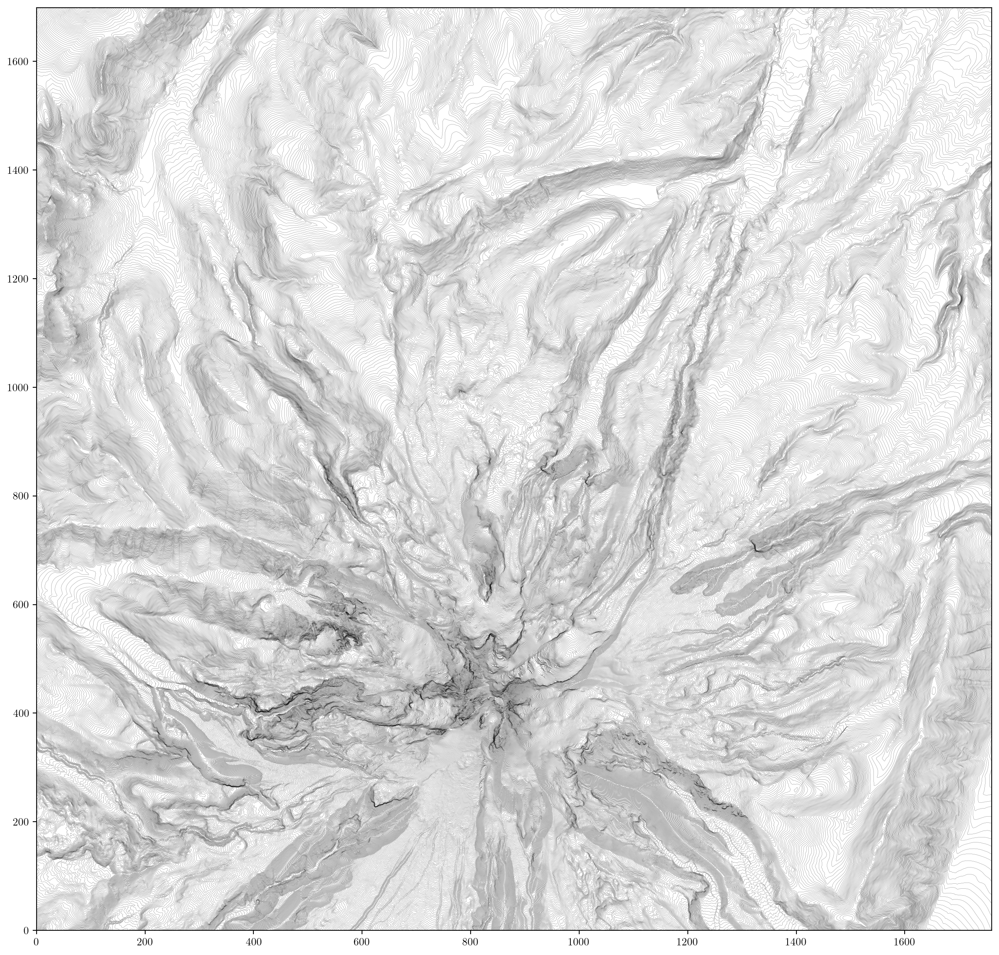

In [5]:
plt.figure(figsize=(16,16))
cs = plt.contour(resampled[::-1], levels=700, colors='k', linewidths=.1)
xlim, ylim = plt.xlim(), plt.ylim()
plt.axis('scaled')
plt.show()

In [6]:
for contour in cs.collections:
    for path in contour.get_paths():
        path.vertices *= 110950/10812

## Isolating contours above a constant elevation

This algorithm simply discards contours that are not closed, then discards any contours that lie outside the perimeter of the largest remaining contour.

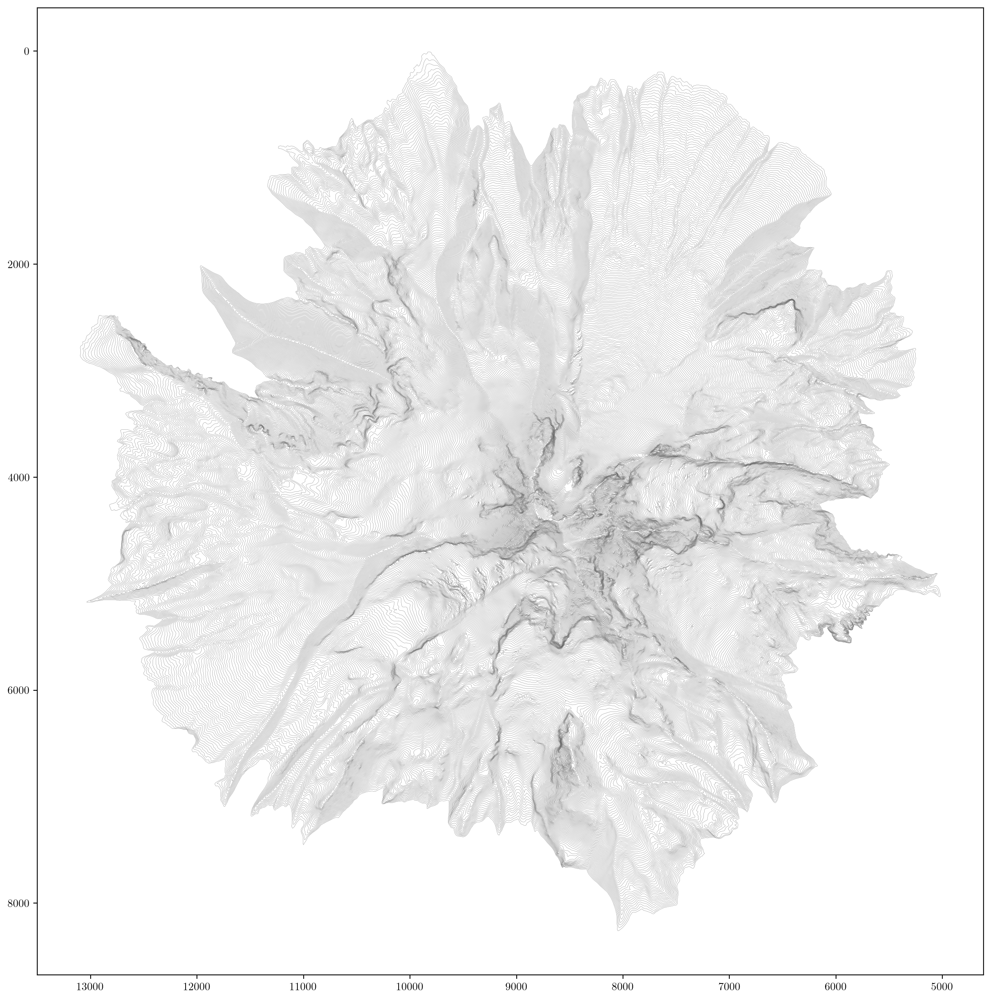

In [7]:
paths = []
path_indices = []

# Select only closed contours
for i, c in enumerate(cs.collections):
    ps = c.get_paths()
    for p in ps:
        if np.all(p.vertices[0] == p.vertices[-1]):
            paths.append(p)
            path_indices.append(i)

sizes = np.array(list(p.vertices.shape[0] for p in paths))
max_size = np.max(sizes)
max_index = np.argmax(sizes)
max_path = paths[max_index]
min_contour_level = path_indices[max_index]

filtered = []
filtered_indices = []

# Select only contours lying within the outermost contour
for i, p in zip(path_indices, paths):
    if p.vertices.shape[0] != max_size:
        if max_path.contains_point(p.vertices[0]):
            filtered.append(p)
            filtered_indices.append(i)
    else:
        filtered.append(p)
        filtered_indices.append(i)

# Plot filtered contours
fig, ax = plt.subplots(figsize=(16,16))
for p in filtered:  
    patch = patches.PathPatch(p, lw=.1, edgecolor='k', facecolor='white')
    ax.add_patch(patch)

# Plot summit contour
#patch = patches.PathPatch(max_path, lw=.6, edgecolor='red', facecolor='None')
ax.add_patch(patch)
#plt.xlim(xlim)
#plt.ylim(ylim)
plt.axis('scaled')
#plt.axis('off')
plt.gca().invert_yaxis()
plt.gca().invert_xaxis()
plt.show()

## Rescale x and y values, apply perspective

After applying rotations in the 

5018.341461182894 13098.182443348518 5.3944490862964285 8259.819846178796


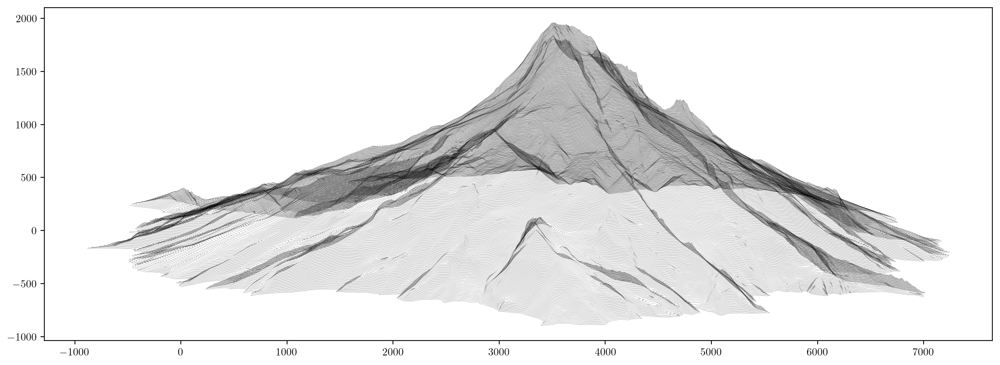

557623


In [8]:
# Find minimum elevation 
min_height, max_height = np.min(hood_data), np.max(hood_data)
diff_height = max_height - min_height
true_min =  min_height + diff_height * min_contour_level / len(cs.collections)

# Rotations: x controls tilt, z controls spin
x_angle = -42
z_angle = -195
z_angle_2 = 1
rx = R.from_euler('x', x_angle, degrees=True)
rz = R.from_euler('z', z_angle, degrees=True)
rz2 = R.from_euler('z', 1, degrees=True)

running_sum = np.zeros(2)
running_count = 0
x_min = 1e10
y_min = 1e10
x_max = -1e10
y_max = -1e10

# Compute means, mins, maxes along x and y axes
for p in filtered:
    running_count += p.vertices.shape[0]
    running_sum += np.sum(p.vertices, axis=0)
    x_max = max(np.max(p.vertices.T[0]), x_max)
    y_max = max(np.max(p.vertices.T[1]), y_max)
    x_min = min(np.min(p.vertices.T[0]), x_min)
    y_min = min(np.min(p.vertices.T[1]), y_min)

print(x_min, x_max, y_min, y_max)

means = running_sum / running_count
vertices = []
x_values = []
y_values = []
z_values = []
point_sum = 0
plt.figure(figsize=(16,16))
for i, p in zip(filtered_indices, filtered):
    # i designates the contour level to which point p belongs
    z_height = min_height + diff_height * i / len(cs.collections)
    for xy in p.vertices.copy():
        vertices.append(xy)
    x, y = p.vertices.T.copy()
    perspective_factor = .1


    # Center points by subtracting means, otherwise rotations don't work
    xy = np.column_stack((x - means[0] - 3500, y - means[1]))
    zs = (np.full((xy.shape[0]), z_height) - true_min)
    zs *= 1.10
    point_sum += xy.shape[0]
    # Apply rotations and project down to 2 dimensions
    x, y, z = rz2.apply(rx.apply(rz.apply(np.hstack((xy, zs.reshape(-1,1)))))).T
    y += .85 * z
    x += .07 * z
    y -= .000005 * x**2
    for ex in x:
        x_values.append(ex)
    for why in y:
        y_values.append(why)
    for zed in z:
        z_values.append(zed)
    plt.plot(x, y, lw=.1, c='k')
plt.axis('scaled')
plt.show()
print(point_sum)

## Delaunay Triangulation

Next we compute the Delaunay triangulation of the original contour data. Although this yields some triangles containing points lying outside the outermost contour, these triangles will not influence the Z-buffer computations since they will never occlude other points when the camera lies anywhere above the plane spanned by the lowest contour.

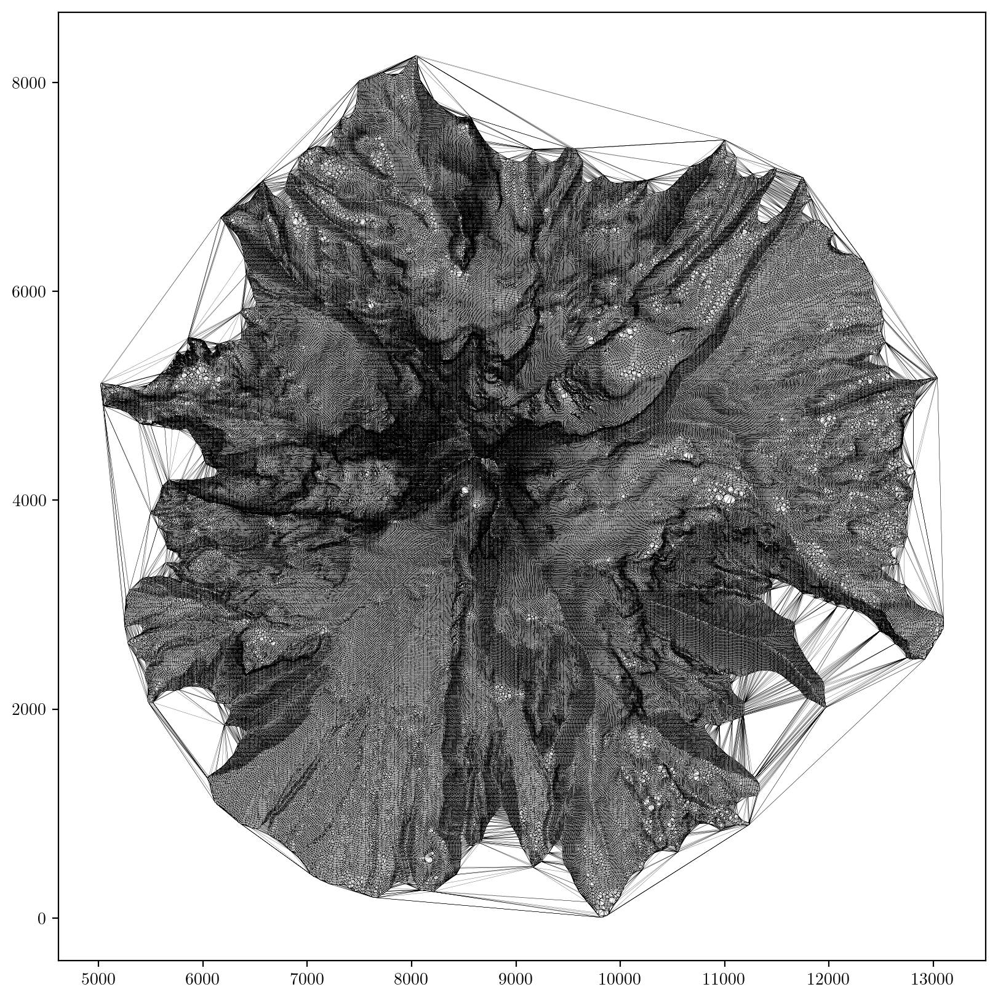

In [9]:
xy = np.array(vertices)
tri_cone = Delaunay(xy)

plt.figure(figsize=(10,10))
plt.triplot(*xy.T, tri_cone.simplices, lw=.1, c='k')
#plt.scatter(*xy.T, s=.1, c='k')
plt.axis('scaled')
plt.show()

## Z-buffer

Next we use a Z-buffer to compute triangle occlusion, converting each triangle to barycentric coordinates and sampling along a regular grid to determine the maximum Z-values at each point.

In [10]:
class Z_Buffer:
    
    def __init__(self, left, right, bottom, top, buffer_width, buffer_height):   
        self.buffer = np.full((buffer_height, buffer_width), -np.inf)
        self.image_size = np.array([top-bottom, right-left])
        self.lower = np.array([bottom, left])
        self.buffer_size = np.array([buffer_height, buffer_width])

    # Convert from coordinates to buffer indices
    def coord_to_index(self, coord):
        return np.floor(.01 + (self.buffer_size-1) * (coord - self.lower) / self.image_size)

    # Convert from buffer indices to coordinates
    def index_to_coord(self, index):
        return (index / (self.buffer_size - 1)) * self.image_size + self.lower

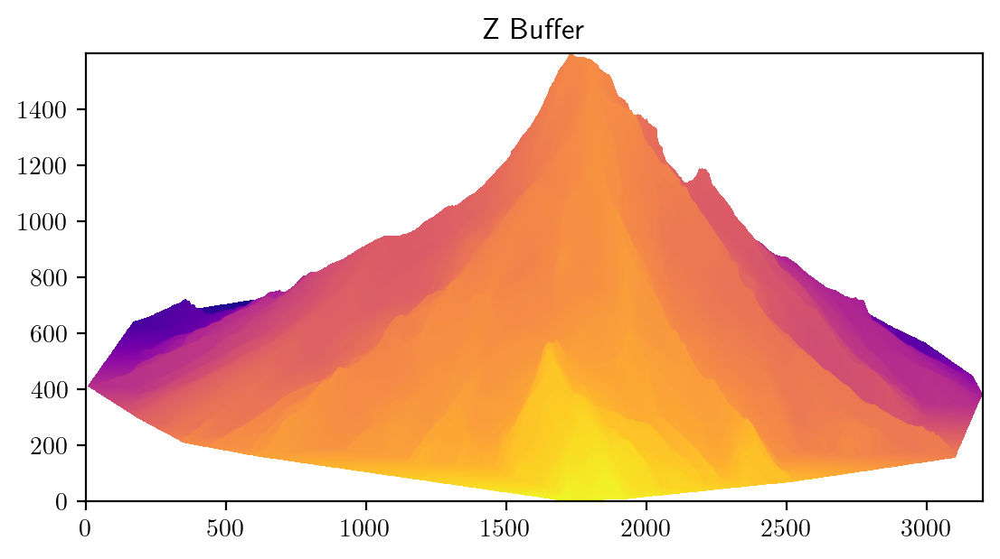

In [11]:
x_values = np.array(x_values)
y_values = np.array(y_values)
z_values = np.array(z_values)

zb3 = Z_Buffer(np.min(y_values), np.max(y_values), np.min(x_values), np.max(x_values), 1600, 3200)

for i, t in enumerate(tri_cone.simplices):
    bottom, left = zb3.coord_to_index(np.array([np.min(x_values[t]), np.min(y_values[t])]))
    top, right = zb3.coord_to_index(np.array([np.max(x_values[t]), np.max(y_values[t])]))
    x_ind, y_ind = np.meshgrid(np.arange(bottom, top+1), np.arange(left, right+1))
    xy = zb3.index_to_coord(np.array((x_ind.flatten(), y_ind.flatten())).T)

    points = np.array([x_values[t], y_values[t]]).T
    single = Delaunay(points)

    b = single.transform[0,:2].dot(np.transpose(xy - single.transform[0,2]))
    weights = np.c_[np.transpose(b), 1 - b.sum(axis=0)]

    # Find ordering of points in triangle relative to original order
    tri_points = single.points[single.simplices[0]]

    u = np.argwhere(np.all(np.equal(points[0], tri_points), axis=1))
    v = np.argwhere(np.all(np.equal(points[1], tri_points), axis=1))
    w = np.argwhere(np.all(np.equal(points[2], tri_points), axis=1))

    weights = weights.T[np.array([u, v, w]).flatten()].T
    bary_zs = np.dot(weights, z_values[t])
    
    x_filtered, y_filtered = xy[np.all(weights>0, axis=1).T].T
    z_filtered = bary_zs[np.all(weights>0, axis=1).T].T
    xi, yi = zb3.coord_to_index(np.array([x_filtered, y_filtered]).T).T.astype(np.int64)
    zb3.buffer[xi, yi] = np.maximum(z_filtered, zb3.buffer[xi, yi])

plt.imshow(zb3.buffer.T, origin='lower', cmap='plasma')
plt.axis('scaled')
plt.title("Z Buffer")
plt.show()

## Final Steps

Now that we have computed z-values for each triangle in the Delaunay triangulation, we can determine which points in each contour are occluded. Since the output is an SVG intended to be sent to an XY plotter, we want to keep contours contiguous. Stepping through each contour, we section off contiguous unoccluded segments into individual paths. The `margin` parameter is a bit of a hack to avoid keeping track of which simplices each point belongs to in the Z-buffer, since unoccluded points may have slightly lower z-values than their correspoinding pixel entry in the Z-buffer.

TODO:
No need to recompute perspective transformation

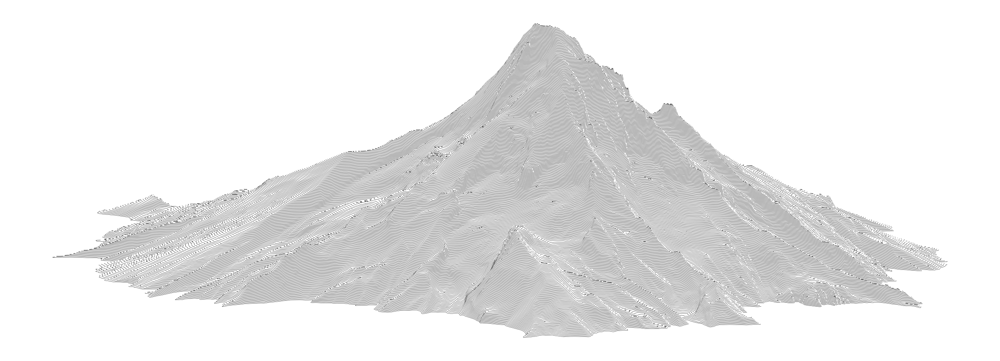

In [12]:
plt.figure(figsize=(16,16))
for i, p in zip(filtered_indices, filtered):
    
    # i designates the contour level to which point p belongs
    z_height = min_height + diff_height * i / len(cs.collections)
    x, y = p.vertices.T.copy()

    # Center points by subtracting means, otherwise rotations don't work
    xy = np.column_stack((x - means[0] - 3500, y - means[1]))
    zs = (np.full((xy.shape[0]), z_height) - true_min)
    zs *= 1.10
    # Apply rotations and project down to 2 dimensions
    #zs += perspective_factor * xy.T[1].reshape(y.shape[0], 1)
    x, y, z = rz2.apply(rx.apply(rz.apply(np.hstack((xy, zs.reshape(-1,1)))))).T
    y += .85 * z
    x += .07 * z
    y -= .000005 * x**2
    
    vertex_sets = []
    current_set = []
    margin = 7
    for i in range(len(x)):
        xy_coords = zb3.coord_to_index(np.array([x[i], y[i]])).astype(np.int64)
        zed = zb3.buffer[xy_coords[0], xy_coords[1]]
        if z[i] + margin > zed:
            current_set.append(np.array([x[i], y[i]]))
        else:
            if len(current_set) < 2:
                current_set = []
            else:
                vertex_sets.append(np.array(current_set))
                current_set = []
    if current_set:
        vertex_sets.append(np.array(current_set))

    for xy in vertex_sets:
        plt.plot(*xy.T, lw=.2, c='k')
        
plt.axis('scaled')
plt.axis('off')
plt.savefig('wyeast2.svg')
plt.show()